In [1]:
from sklearn.metrics import mutual_info_score

import descriptive_ana as da
import numpy as np
import seaborn as sns
import cudf
from cuml import KMeans
from cuml.cluster import KMeans
%load_ext cudf.pandas
import pandas as pd
import hvplot.pandas
import holoviews as hv
import glob
from holoviews import opts
hv.extension('bokeh')
import hvplot.cudf
import matplotlib.pyplot as plt

In [110]:
cudf_df = cudf.read_csv('datasets/combined.csv')
print(type(cudf_df))
cudf_df = cudf_df.drop(columns=['Unnamed:_0'])
cudf_df = cudf_df.drop(columns=['Fwd_Header_Length.1'])

<class 'cudf.core.dataframe.DataFrame'>


In [119]:
import plotly.express as px
# Plotly 3D scatter plot
fig = px.scatter_3d(df_copy, x='Packet_Length_Std', y='Average_Packet_Size', z='Label', color='Label',
                    labels={'Label': 'Class (Z-axis)'},
                    title='3D Scatter Plot with Class Separation')
fig.show()

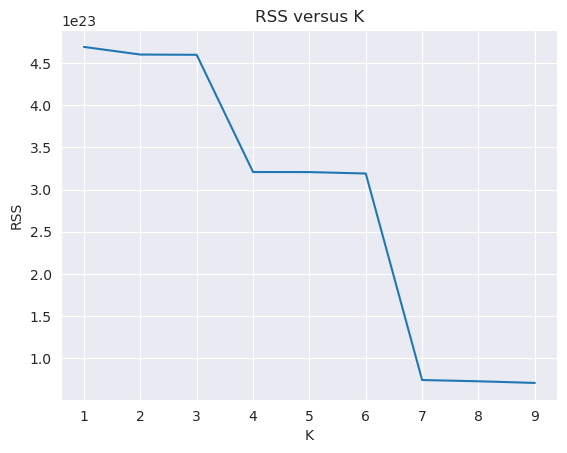

In [20]:
features = cudf_df.select_dtypes(include=np.number)

def kmean_score(nclust):
    km = KMeans(n_clusters=nclust, random_state=30)
    km.fit(features)
    rss = -km.score(features)
    return rss

scores = [kmean_score(i) for i in range(1, 10)]

plt.plot(range(1, 10), scores)
plt.xlabel('K')
plt.ylabel('RSS')
plt.title('RSS versus K')

plt.show()

In [23]:
df_copy = cudf_df.copy()
features = df_copy.select_dtypes(include=np.number)

constant_features = []

for i in features.columns:
    unique = features[i].unique()
    print(f'{i}: {unique.size}')
    if unique.size == 1:
        constant_features.append(i)

print("Features with only one unique value:", constant_features)

Source_Port: 52661
Destination_Port: 64494
Protocol: 3
Flow_Duration: 70565
Total_Fwd_Packets: 300
Total_Backward_Packets: 398
Total_Length_of_Fwd_Packets: 3986
Total_Length_of_Bwd_Packets: 4496
Fwd_Packet_Length_Max: 1836
Fwd_Packet_Length_Min: 630
Fwd_Packet_Length_Mean: 6252
Fwd_Packet_Length_Std: 6068
Bwd_Packet_Length_Max: 1067
Bwd_Packet_Length_Min: 214
Bwd_Packet_Length_Mean: 5863
Bwd_Packet_Length_Std: 5957
Flow_Bytes/s: 83676
Flow_Packets/s: 72225
Flow_IAT_Mean: 72594
Flow_IAT_Std: 85398
Flow_IAT_Max: 65017
Flow_IAT_Min: 2030
Fwd_IAT_Total: 60262
Fwd_IAT_Mean: 61029
Fwd_IAT_Std: 71629
Fwd_IAT_Max: 54211
Fwd_IAT_Min: 402
Bwd_IAT_Total: 31961
Bwd_IAT_Mean: 32141
Bwd_IAT_Std: 32275
Bwd_IAT_Max: 31417
Bwd_IAT_Min: 96
Fwd_PSH_Flags: 2
Bwd_PSH_Flags: 1
Fwd_URG_Flags: 1
Bwd_URG_Flags: 1
Fwd_Header_Length: 1231
Bwd_Header_Length: 914
Fwd_Packets/s: 71624
Bwd_Packets/s: 52170
Min_Packet_Length: 577
Max_Packet_Length: 1893
Packet_Length_Mean: 8229
Packet_Length_Std: 7696
Packet_Length_V

In [25]:
df_copy = cudf_df.copy()
features = df_copy.select_dtypes(include=np.number)

constant_features = []

for i in features.columns:
    unique = features[i].unique()
    print(f'{i}: {unique.size}')
    if unique.size == 1:
        constant_features.append(i)

print("Features with only one unique value:", constant_features)
features = features.drop(columns=constant_features)

df_copy['Label'] = df_copy['Label'].astype('category').cat.codes.astype('int32')


Source_Port: 52661
Destination_Port: 64494
Protocol: 3
Flow_Duration: 70565
Total_Fwd_Packets: 300
Total_Backward_Packets: 398
Total_Length_of_Fwd_Packets: 3986
Total_Length_of_Bwd_Packets: 4496
Fwd_Packet_Length_Max: 1836
Fwd_Packet_Length_Min: 630
Fwd_Packet_Length_Mean: 6252
Fwd_Packet_Length_Std: 6068
Bwd_Packet_Length_Max: 1067
Bwd_Packet_Length_Min: 214
Bwd_Packet_Length_Mean: 5863
Bwd_Packet_Length_Std: 5957
Flow_Bytes/s: 83676
Flow_Packets/s: 72225
Flow_IAT_Mean: 72594
Flow_IAT_Std: 85398
Flow_IAT_Max: 65017
Flow_IAT_Min: 2030
Fwd_IAT_Total: 60262
Fwd_IAT_Mean: 61029
Fwd_IAT_Std: 71629
Fwd_IAT_Max: 54211
Fwd_IAT_Min: 402
Bwd_IAT_Total: 31961
Bwd_IAT_Mean: 32141
Bwd_IAT_Std: 32275
Bwd_IAT_Max: 31417
Bwd_IAT_Min: 96
Fwd_PSH_Flags: 2
Bwd_PSH_Flags: 1
Fwd_URG_Flags: 1
Bwd_URG_Flags: 1
Fwd_Header_Length: 1231
Bwd_Header_Length: 914
Fwd_Packets/s: 71624
Bwd_Packets/s: 52170
Min_Packet_Length: 577
Max_Packet_Length: 1893
Packet_Length_Mean: 8229
Packet_Length_Std: 7696
Packet_Length_V

[W] [14:12:12.714813] Warning(`fit`): As of v0.16, PCA invoked without an n_components argument defaults to using min(n_samples, n_features) rather than 1
Number of components needed for 95% variance: 9


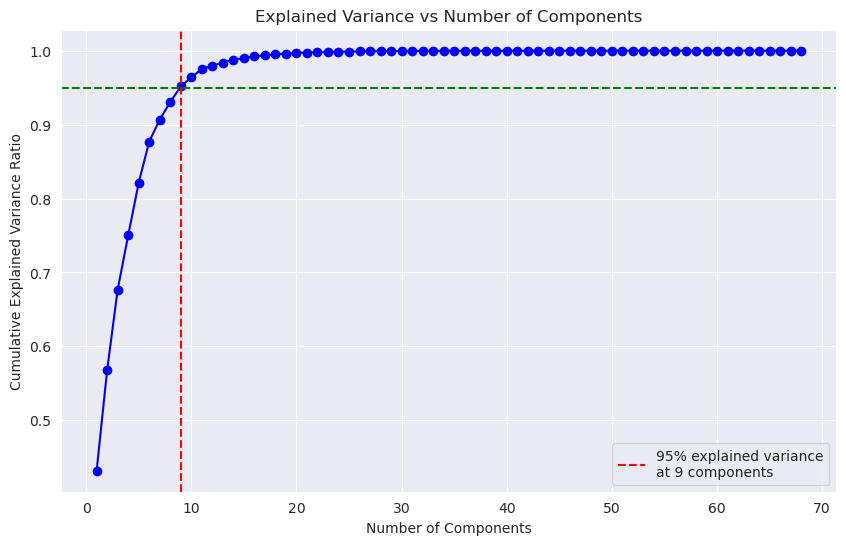

In [81]:
from cuml import PCA
from cuml.preprocessing import MinMaxScaler, StandardScaler, RobustScaler, PowerTransformer

scaler = MinMaxScaler()
#scaled = scaler.fit(features)
x_scaled = scaler.fit_transform(features)
# Fit PCA
pca = PCA()
pca.fit(x_scaled)

# Calculate cumulative variance ratio
cumulative_variance = np.cumsum(pca.explained_variance_ratio_)

# Find number of components for 95% variance
n_components_95 = np.argmax(cumulative_variance >= 0.95) + 1

# Create the plot
plt.figure(figsize=(10, 6))

# Plot cumulative explained variance
plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, 'bo-')

# Add vertical line at 95% components
plt.axvline(x=n_components_95, color='r', linestyle='--',
            label=f'95% explained variance\nat {n_components_95} components')

# Add horizontal line at 95%
plt.axhline(y=0.95, color='g', linestyle='--')

plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Explained Variance vs Number of Components')
plt.grid(True)
plt.legend()

# Print the number
print(f"Number of components needed for 95% variance: {n_components_95}")


Number of components needed for 95% variance: 9


In [124]:
# Clustering model trained on GPU for faster training
from cuml.preprocessing import MinMaxScaler, StandardScaler, RobustScaler, PowerTransformer
import cupy
from cuml import PCA
#df_copy = cudf_df.copy()
#features = df_copy.select_dtypes(include=np.number)
#df_copy['Label'] = df_copy['Label'].astype('category').cat.codes.astype('int32')


# First apply Yeo-Johnson transformation
#pt = PowerTransformer()
#x_transformed = pt.fit_transform(features)



scaler = MinMaxScaler()
#scaled = scaler.fit(features)
x_scaled = scaler.fit_transform(features)
pca = PCA(n_components=3)
x_pca = pca.fit_transform(x_scaled)
kmeans_model = KMeans(n_clusters=7, random_state=30)
df_copy['clusters'] = kmeans_model.fit_predict(x_pca)

In [125]:
import cuml.metrics.cluster as clustermetrics
labels = df_copy['Label']
clusters = df_copy['clusters']

sil_score = clustermetrics.silhouette_score(clusters, labels)
print("Silhouette Score:", sil_score)

hom_score = clustermetrics.homogeneity_score(clusters, labels)
print("Homogeneity Score:", hom_score)

com_score = clustermetrics.completeness_score(labels, clusters)
print("Completeness Score:", com_score)

mutual_score = clustermetrics.mutual_info_score(labels, clusters)
print("Mutual Info Score:", mutual_score)

Silhouette Score: 0.23611757159233093
Homogeneity Score: nan
Completeness Score: nan
Mutual Info Score: nan


In [126]:
print("Unique cluster values:", clusters.unique())
print("Unique label values:", labels.unique())
print("\nCluster value counts:")
print(clusters.value_counts().sort_index())
print("\nLabel value counts:")
print(labels.value_counts().sort_index())


Unique cluster values: [3 2 6 0 5 4 1]
Unique label values: [2 1 0 4 3 6 5]

Cluster value counts:
clusters
0    94292
1    12071
2    80868
3    60811
4    57489
5    33099
6    60125
Name: count, dtype: int64

Label value counts:
Label
0    56965
1    56965
2    56965
3    56965
4    56965
5    56965
6    56965
Name: count, dtype: int64


In [2]:
import plotly.express as px
# Plotly 3D scatter plot
fig = px.scatter_3d(cudf_df, x='Packet_Length_Std', y='Average_Packet_Size', z='Label', color='Label',
                    labels={'Label': 'Class (Z-axis)'},
                    title='3D Scatter Plot with Class Separation')
fig.show()

NameError: name 'cudf_df' is not defined

In [1]:
import plotly.express as px
# Plotly 3D scatter plot
fig = px.scatter_3d(df_copy, x='Packet_Length_Std', y='Average_Packet_Size', z='clusters', color='clusters',
                    labels={'clusters': 'Class (Z-axis)'},
                    title='3D Scatter Plot with Class Separation')
fig.show()

NameError: name 'df_copy' is not defined